# Altair Examples

## Getting Started


In [2]:
import pandas as pd
import altair as alt
from vega_datasets import data

## Simple Bar Charts

In [3]:
production = pd.DataFrame(
    {"location": ["Sacramento", "Lansing", "Charlotte", "San Antonio", "Tallahassee"],
     "units_produced": [5000, 3276, 2915, 6475, 4249]
    }
)

In [4]:
production.head()

,location,units_produced
0,Sacramento,5000
1,Lansing,3276
2,Charlotte,2915
3,San Antonio,6475
4,Tallahassee,4249


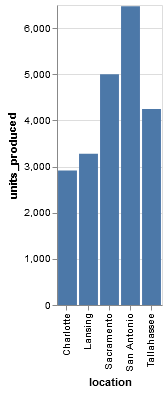

In [14]:
# Note that by default, the city names are sorted alphabetically in ascending order.

alt.Chart(
    data=production
).mark_bar(
).encode(
    x="location:N",
    y="units_produced:Q"
)

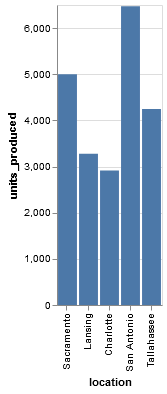

In [15]:
# We can use the sort attribute of the x encoding channel to change this.  Here, let's specify
# no sorting (i.e. leave the cities in the order they appear in the dataset).

alt.Chart(
    data=production
).mark_bar(
).encode(
    x=alt.X(shorthand="location:N", sort=None),
    y="units_produced:Q"
)

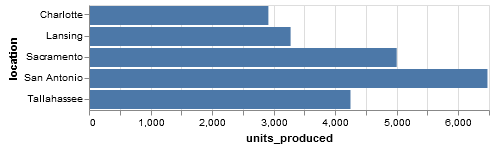

In [16]:
# We can also flip the axes so that we have horizontal bars.

alt.Chart(
    data=production
).mark_bar(
).encode(
    y="location:N",
    x="units_produced:Q"
)

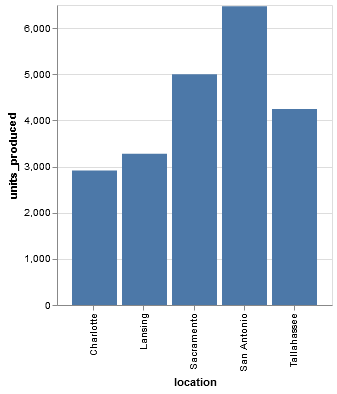

In [18]:
# We can also play with the bar widths and spacing if desired. These are controlled by attributes within
# the scale attribute of the X or Y channel encoding.  rangeStep is the number of pixels from the start of
# one bar to the start of the next bar (adjusts width of bars). paddingInner and paddingOuter are a fraction
# between 0 and 1. The spacing between bars is paddingInner*rangeStep and the spacing between the bars and
# outer edge of the plot is paddingOuter*rangeStep.  If you wish to make the inner and outer padding the same,
# you can just use the attribute called padding.

alt.Chart(
    data=production
).mark_bar(
).encode(
    x=alt.X(
        shorthand="location:N",
        scale=alt.Scale(
            #padding=0.1
            paddingInner=0.1,
            paddingOuter=0.3,
            rangeStep=50,
        )
    ),
    y="units_produced:Q"
)

## Stacked Area Chart

By default, the area mark creates a stacked area chart.

In [33]:
iowa = data.iowa_electricity()

In [34]:
iowa.head()

,year,source,net_generation
0,2001-01-01,Fossil Fuels,35361
1,2002-01-01,Fossil Fuels,35991
2,2003-01-01,Fossil Fuels,36234
3,2004-01-01,Fossil Fuels,36205
4,2005-01-01,Fossil Fuels,36883


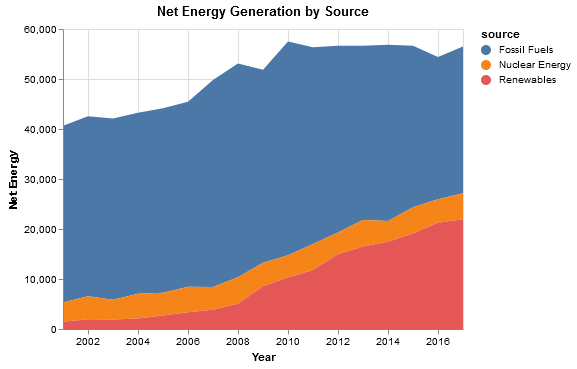

In [40]:
# Creates a stacked area chart by default.

# Note that we can use the longhand alt.X() and alt.Y() to change the x and y
# axis labels

# The opacity encoding can be useful to see the gridlines behind the shaded areas.

alt.Chart(
    data=iowa,
    title="Net Energy Generation by Source"
).mark_area(
).encode(
    x=alt.X("year(year):T", title='Year'),
    y=alt.Y("net_generation:Q", title='Net Energy'),
    color="source:N",
    #opacity=alt.value(1)
)

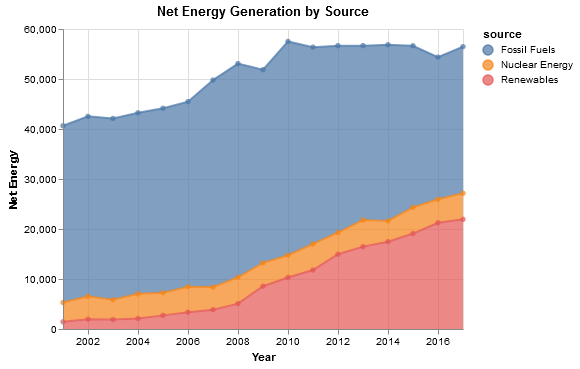

In [37]:
# We can specify the interpolation method and show data points and lines within the 
# mark_area() method. Let's also add a tooltip to see the data values.

alt.Chart(
    data=iowa,
    title="Net Energy Generation by Source"
).mark_area(
    point=True,
    line=True,
    interpolate="linear"   # e.g. linear, basis(B-spline), step 
).encode(
    x=alt.X("year(year):T", title='Year'),
    y=alt.Y("net_generation:Q", title='Net Energy'),
    color="source:N",
    opacity=alt.value(0.7),
    #tooltip=[alt.Tooltip("year(year):T", title="Year"), 
             #alt.Tooltip("net_generation:Q", title="Net Energy")]
)

It is possible to use the *stack* attribute of the X or Y encodings to create variations of this area chart.  Stack can take on the following values:

- 'zero': (default): stacking with baseline offset at zero
- None: no stacking; this produces a layered area chart
- 'normalize': stacking with a normalized domain (0 to 1)
- 'center': stacking with a center baseline for creating streamgraphs



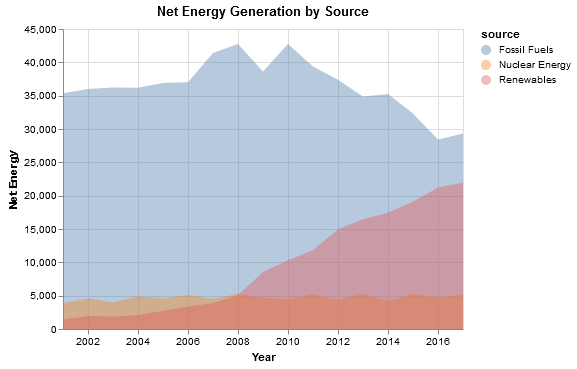

In [39]:
# A layered area graph (no stacking)

alt.Chart(
    data=iowa,
    title="Net Energy Generation by Source"
).mark_area(
).encode(
    x=alt.X("year(year):T", title='Year'),
    y=alt.Y("net_generation:Q", title='Net Energy', stack=None),
    color="source:N",
    opacity=alt.value(0.4)
)

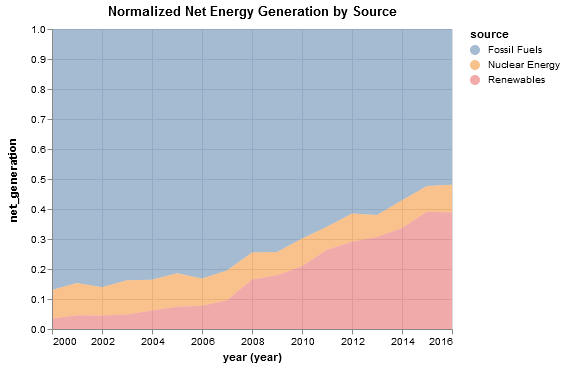

In [39]:
# A normalized stacked area graph

alt.Chart(
    data=iowa,
    title="Normalized Net Energy Generation by Source"
).mark_area(
).encode(
    x="year(year):T",
    y=alt.Y("net_generation:Q", stack="normalize"),
    color="source:N",
    opacity=alt.value(0.5),
)

## Ranged Area Chart (also exploration of timeUnit attribute)

By using Y and Y2 encoding channels, you can create a ranged area.  Below we use the weather data from Seattle which has the min and max temperature for each day from January 1, 2012 to December 31, 2015.

Link to timeUnit in Vega-Lite documentation:
https://vega.github.io/vega-lite/docs/timeunit.html

Link to Axis time format specifications (D3 formats):
https://github.com/d3/d3-time-format#locale_format




In [59]:
weather.head()

,date,precipitation,temp_max,temp_min,wind,weather
0,2012-01-01,0.0,12.8,5.0,4.7,drizzle
1,2012-01-02,10.9,10.6,2.8,4.5,rain
2,2012-01-03,0.8,11.7,7.2,2.3,rain
3,2012-01-04,20.3,12.2,5.6,4.7,rain
4,2012-01-05,1.3,8.9,2.8,6.1,rain


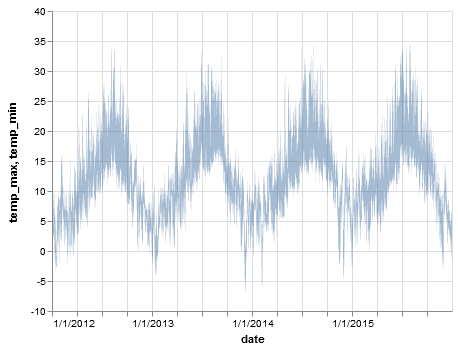

In [52]:
# Basic range area chart. The max temperature is specified using encoding 
# channel Y and the min temperature is specified with encoding channel Y2.
# An area range is filled in between the two extremes.

# The interactive method enables panning and zooming.

alt.Chart(
    data=weather
).mark_area(
).encode(
    x=alt.X("date:T", axis=alt.Axis(format="%x")),
    y=alt.Y("temp_max:Q"),
    y2=alt.Y2("temp_min:Q"),
    opacity=alt.value(0.5)
#).interactive(
#    bind_x=True,
#    bind_y=False
)

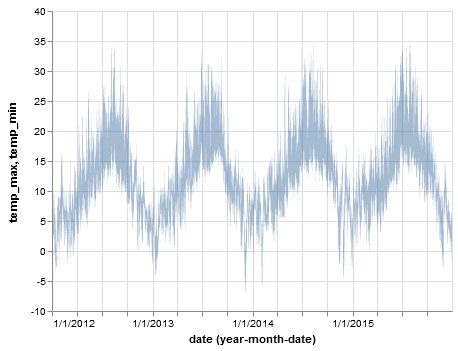

In [138]:
# Note that this is the same graph as above, but we are being specific about
# the time values specified on the X axis.  The timeUnit is explicitly given as
# yearmonthdate, which means that each date is considered a separate data point.
# See the next graph for a different timeUnit.

alt.Chart(
    data=weather
).mark_area(
).encode(
    x=alt.X("date:T", timeUnit="yearmonthdate", axis=alt.Axis(format="%x")),
    y=alt.Y("temp_max:Q"),
    y2=alt.Y2("temp_min:Q"),
    opacity=alt.value(0.5)
).interactive(
    bind_x=True,
    bind_y=False
)

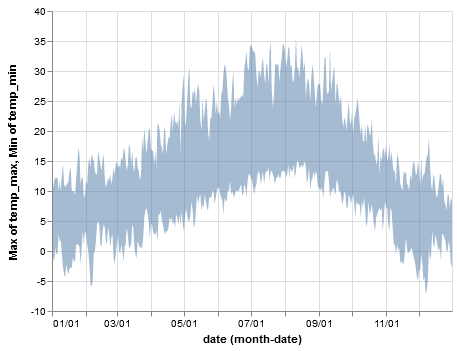

In [45]:
# Here, the timeUnit is specified as monthdate (month/day).  This means that only the
# month and day are unique. For example, Jan 12, or Aug 25.  The year is not
# considered part of the timeUnit.  This means that the dates 1-3-12, 1-3-13,
# 1-3-14, and 1-3-15 are grouped together. To get values for temp_max and 
# temp_min, we will have to use an aggregate function to specify how to get a
# specific value to plot from the four grouped values. Here, we specify that
# the temp_max for a particular month/day is the maximum of the four values.
# Likewise, the temp_min is the minimum of the four values.

alt.Chart(
    data=weather
).mark_area(
).encode(
    x=alt.X("date:T", timeUnit="monthdate", axis=alt.Axis(format="%m/%d")),
    y=alt.Y("max(temp_max):Q"),
    y2=alt.Y2("min(temp_min):Q"),
    opacity=alt.value(0.5)
).interactive(
    bind_x=True,
    bind_y=False
)

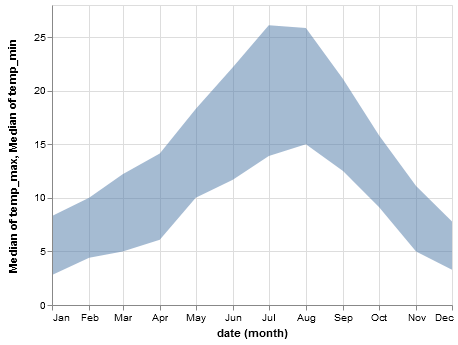

In [46]:
# We could go further and make the timeUnit just the month.  Then, the values
# on the x-axis are only Jan through Dec (only 12). So, for example, for
# x = January, all the January dates in all four years are grouped together.
# We again use an aggregate function to specify how to come up with values for
# temp_max and temp_min.  This time, we have chosen to calculate the median
# for each group.

alt.Chart(
    data=weather
).mark_area(
).encode(
    x=alt.X("date:T", timeUnit="month", axis=alt.Axis(format="%b")),
    y=alt.Y("median(temp_max):Q"),
    y2=alt.Y2("median(temp_min):Q"),
    opacity=alt.value(0.5)
).interactive(
    bind_x=True,
    bind_y=False
)

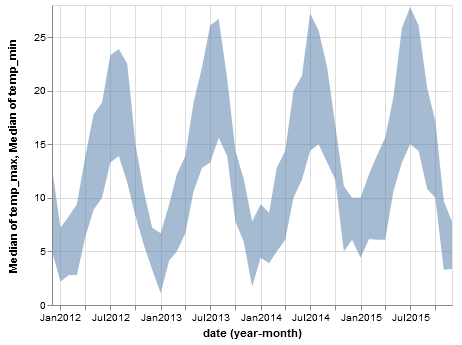

In [130]:
# As a final example, we choose timeUnit to be yearmonth and the aggregate
# function to be median.

alt.Chart(
    data=weather
).mark_area(
).encode(
    x=alt.X("date:T", timeUnit="yearmonth", axis=alt.Axis(format="%b%Y")),
    y=alt.Y("median(temp_max):Q"),
    y2=alt.Y2("median(temp_min):Q"),
    opacity=alt.value(0.5)
).interactive(
    bind_x=True,
    bind_y=False
)

## Histograms

In [19]:
movies = data.movies()

In [20]:
movies.head()

,Creative_Type,Director,Distributor,IMDB_Rating,IMDB_Votes,MPAA_Rating,Major_Genre,Production_Budget,Release_Date,Rotten_Tomatoes_Rating,Running_Time_min,Source,Title,US_DVD_Sales,US_Gross,Worldwide_Gross
0,None,None,Gramercy,6.1,1071.0,R,None,8000000.0,12-Jun-98,NaN,NaN,None,The Land Girls,NaN,146083.0,146083.0
1,None,None,Strand,6.9,207.0,R,Drama,300000.0,7-Aug-98,NaN,NaN,None,"First Love, Last Rites",NaN,10876.0,10876.0
2,None,None,Lionsgate,6.8,865.0,None,Comedy,250000.0,28-Aug-98,NaN,NaN,None,I Married a Strange Person,NaN,203134.0,203134.0
3,None,None,Fine Line,NaN,NaN,None,Comedy,300000.0,11-Sep-98,13.0,NaN,None,Let's Talk About Sex,NaN,373615.0,373615.0
4,Contemporary Fiction,None,Trimark,3.4,165.0,R,Drama,1000000.0,9-Oct-98,62.0,NaN,Original Screenplay,Slam,NaN,1009819.0,1087521.0


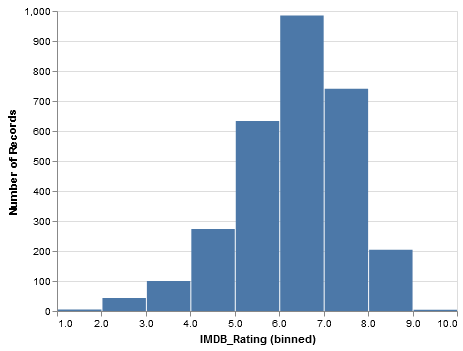

In [21]:
# To make a histogram of the number of movies with certain IMDB ratings, we can
# bin the IMDB ratings and count the number of films in each bin.

alt.Chart(
    data=movies
).mark_bar(
).encode(
    x=alt.X(shorthand="IMDB_Rating:Q", bin=True),
    y="count()"
)

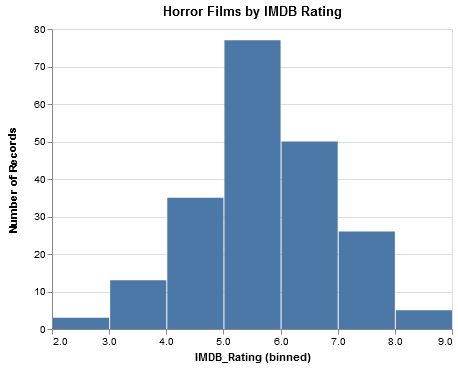

In [22]:
# In the above charts, all films genres are taken into account.  If we wish
# to restrict the bar chart to only plot records of a specific genre
# like Drama, Comedy, Musical, Horror, etc, then we can add a filter.

# When writing expressions involving data field names you must use alt.datum.field

alt.Chart(
    data=movies,
    title="Horror Films by IMDB Rating"
).transform_filter(
    alt.datum.Major_Genre == "Horror"
).mark_bar(
).encode(
    x=alt.X(shorthand="IMDB_Rating:Q", bin=True),
    y="count()"
)

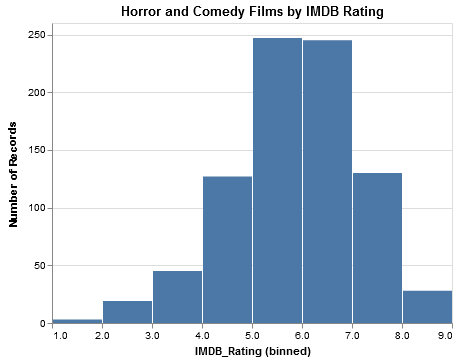

In [26]:
## We can make the filter include both Horror and Comedy genres.

alt.Chart(
    data=movies,
    title="Horror and Comedy Films by IMDB Rating"
).transform_filter(
    filter=(alt.datum.Major_Genre == "Horror") | (alt.datum.Major_Genre == "Comedy")
).mark_bar(
).encode(
    x=alt.X(shorthand="IMDB_Rating:Q", bin=True),
    y="count()"
)

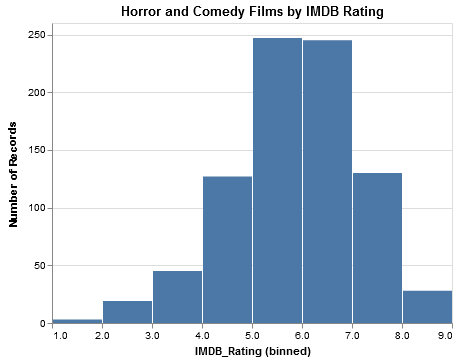

In [27]:
# Another way to create the same filter so that the genre is restricted
# to horror or comedy is to use the specific FieldOneOfPredicate class.
# This allows you to specify a field and then give a "oneOf" list of values
# the field must contain.

alt.Chart(
    data=movies,
    title="Horror and Comedy Films by IMDB Rating"
).transform_filter(
    filter=alt.FieldOneOfPredicate(
        field="Major_Genre",
        oneOf=["Horror", "Comedy"]
    )
).mark_bar(
).encode(
    x=alt.X(shorthand="IMDB_Rating:Q", bin=True),
    y="count()"
)

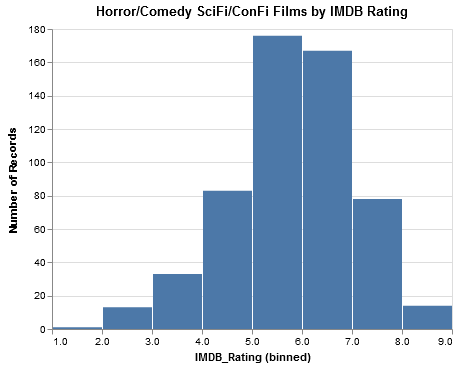

In [28]:
# Transform filters can be chained together to successively restrict
# the data used to make the chart.  Below, we first restrict the genre
# to be either horror or comedy. Then, we restrict these films further
# by requiring that the creative type field be either science fiction
# or contemporary fiction. Note that this results in a different chart.
# Take careful note of the values on the y-axis.

alt.Chart(
    data=movies,
    title="Horror/Comedy SciFi/ConFi Films by IMDB Rating"
).transform_filter(
    filter=alt.FieldOneOfPredicate(
        field="Major_Genre",
        oneOf=["Horror", "Comedy"]
    )
).transform_filter(
    filter=alt.FieldOneOfPredicate(
        field="Creative_Type",
        oneOf=["Science Fiction", "Contemporary Fiction"]
    )
).mark_bar(
).encode(
    x=alt.X(shorthand="IMDB_Rating:Q", bin=True),
    y="count()"
)

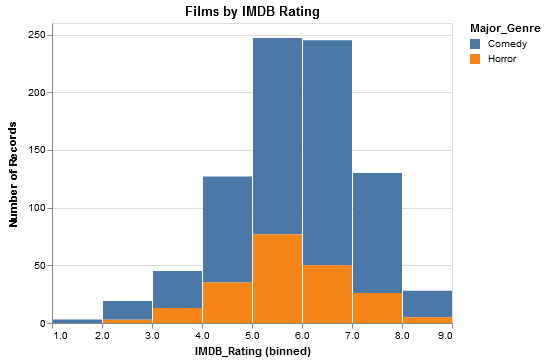

In [64]:
# We can create a stacked bar chart by simply adding a color encoding.
# Here, we use color to denote film genre. We can also customize the legend title.

alt.Chart(
    data=movies,
    title="Films by IMDB Rating"
).transform_filter(
    filter=alt.FieldOneOfPredicate(
        field="Major_Genre",
        oneOf=["Horror", "Comedy"]
    )
).mark_bar(
).encode(
    x=alt.X(shorthand="IMDB_Rating:Q", bin=True),
    y="count()",
    color='Major_Genre:N'
    #color=alt.Color("Major_Genre:N", legend=alt.Legend(title='Major Genre'))
)

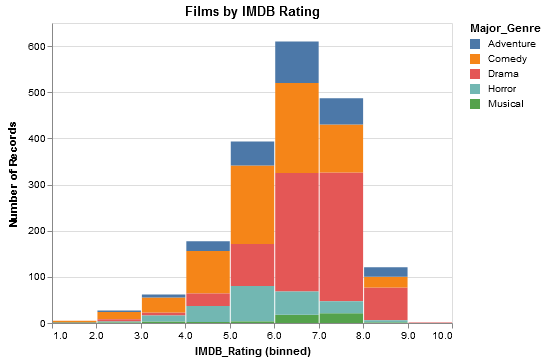

In [65]:
# Let's expand the number of film genres and add a tooltip.

alt.Chart(
    data=movies,
    title="Films by IMDB Rating"
).transform_filter(
    filter=alt.FieldOneOfPredicate(
        field="Major_Genre",
        oneOf=["Horror", "Comedy", "Drama", "Musical", "Adventure"]
    )
).mark_bar(
).encode(
    x=alt.X(shorthand="IMDB_Rating:Q", bin=True),
    y="count()",
    color="Major_Genre:N",
    #tooltip="count()"
)

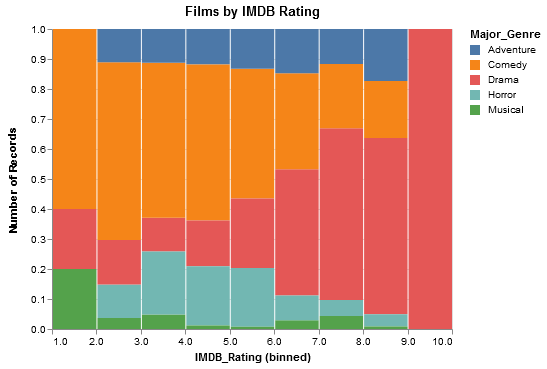

In [66]:
# We can use the stack property of the Y encoding to change the
# stacked bar graph to a normalized stacked bar graph.

alt.Chart(
    data=movies,
    title="Films by IMDB Rating"
).transform_filter(
    filter=alt.FieldOneOfPredicate(
        field="Major_Genre",
        oneOf=["Horror", "Comedy", "Drama", "Musical", "Adventure"]
    )
).mark_bar(
).encode(
    x=alt.X(shorthand="IMDB_Rating:Q", bin=True),
    y=alt.Y(shorthand="count()", stack="normalize"),
    color="Major_Genre:N",
    tooltip="count()"
)

# Scatter Plots Using mark_circle() and mark_point()

### "Circles" are filled circles by default

### "Points" are unfilled shapes (circles, triangles, diamonds, etc)

In [49]:
cars = data.cars()

In [50]:
cars.head()

,Acceleration,Cylinders,Displacement,Horsepower,Miles_per_Gallon,Name,Origin,Weight_in_lbs,Year
0,12.0,8,307.0,130.0,18.0,chevrolet chevelle malibu,USA,3504,1970-01-01
1,11.5,8,350.0,165.0,15.0,buick skylark 320,USA,3693,1970-01-01
2,11.0,8,318.0,150.0,18.0,plymouth satellite,USA,3436,1970-01-01
3,12.0,8,304.0,150.0,16.0,amc rebel sst,USA,3433,1970-01-01
4,10.5,8,302.0,140.0,17.0,ford torino,USA,3449,1970-01-01


## Scatter Plot with Circle Marks

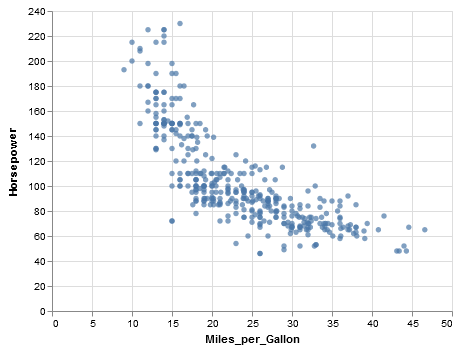

In [51]:
# Scatter plot with marks that are circles.  The circles are filled in by default.

alt.Chart(
    cars
).mark_circle(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q'
).interactive()

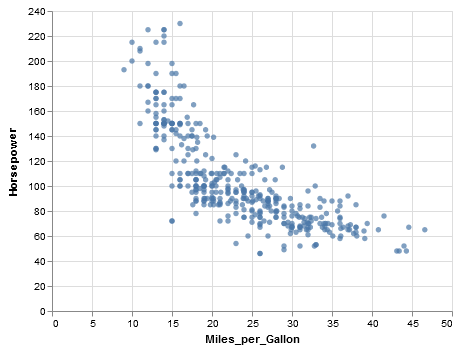

In [57]:
# There are a number of properties that allow for changing the appearance of the circles.

alt.Chart(
    cars
).mark_circle(
    #size=100,  # size of circle
    #filled=True,  # whether circle is filled or not 
    #fill='green',  # color of fill
    #fillOpacity=0.6, # opacity of fill color
    #stroke='black',  # color of the stroke line around the circle
    #strokeWidth=1,  # width in pixels of the stroke line
    #strokeOpacity=1  # opacity of the stroke line
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q'
).interactive()

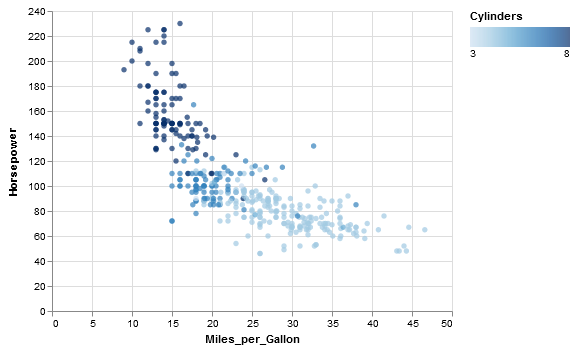

In [56]:
# You can also assign the color encoding channel to particular data field.
# Here, we'll associate the number of cylinders in the engine with color.
# Different data types have different default behavior in the color channel:
# 1) Quantitative: A continuous scale of shades of a single color
# 2) Ordinal: Discrete shades of a single color
# 3) Nominal: A different color is assigned to each value

alt.Chart(
    cars
).mark_circle(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color='Cylinders:Q'
).interactive()

## Scatter Plot with Point Marks

Data points are represented by different shaped symbols (circles, squares, triangles, diamonds).

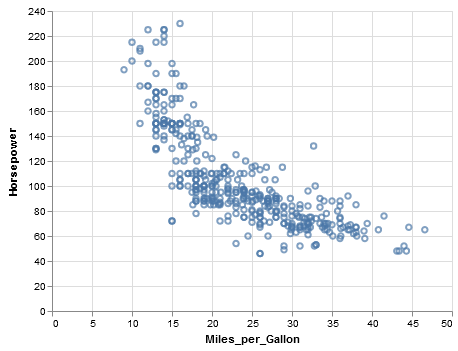

In [8]:
# By default, the first symbol used is an unfilled circle.

alt.Chart(
    data=cars
).mark_point(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q'
)

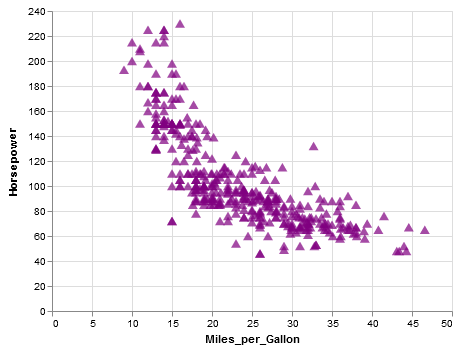

In [57]:
# You can directly control the shape, size, and color of the points.

alt.Chart(
    data=cars
).mark_point(
    shape='triangle-up',
    size=100,
    filled=True,
    fill='purple'
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
).interactive()

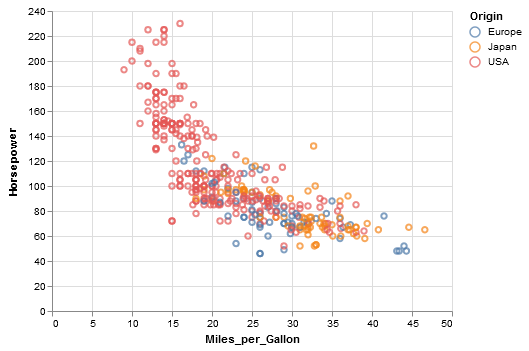

In [67]:
# If we add a color, shape, or size encoding channels...

alt.Chart(
    data=cars
).mark_point(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color='Origin:N',
    #shape='Origin:N',
    #size='Cylinders:N'
).interactive()

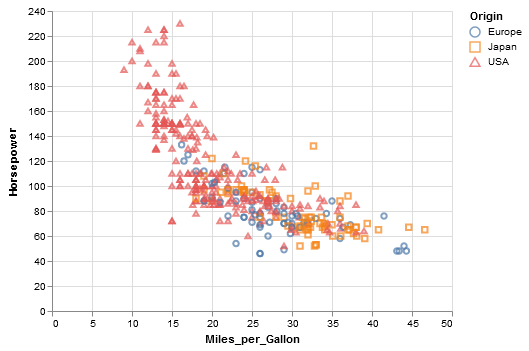

In [11]:
# Adding a Tooltip

alt.Chart(
    data=cars
).mark_point(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color='Origin:N',
    shape='Origin:N',
    tooltip=['Name:N', 'Cylinders:N', 'year(Year):T']
).interactive()

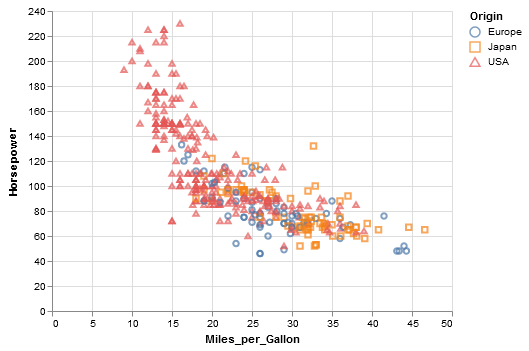

In [69]:
# Can change the attributes of a tooltip entry by using alt.Tooltip()

alt.Chart(
    data=cars,
).mark_point(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color='Origin:N',
    shape='Origin:N',
    tooltip=['Name:N', 'Cylinders:N',
             alt.Tooltip('Year:T', timeUnit='year', title='Year')]
)

## Layering and Concatenating Charts

#### Layering operator (plus):  +
#### Vertical Concatenation operator (ampersand):  &
#### Horizontal Contatenation operator (pipe):  | 

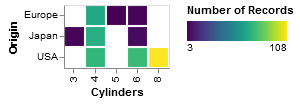

In [80]:
# Can create heatmaps using mark_rect()

alt.Chart(
    data=cars
).mark_rect(
).encode(
    x='Cylinders:O',
    y='Origin:N',
    color='count()'
)

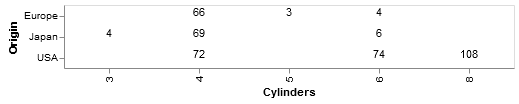

In [81]:
# Can plot text values using mark_text()

alt.Chart(
    data=cars
).mark_text(
).encode(
    x='Cylinders:O',
    y='Origin:N',
    text='count()'
)

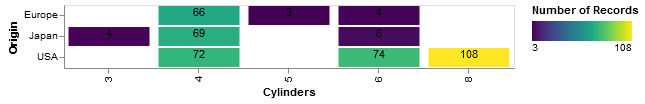

In [77]:
# Let's layer these two graphs together to create a labeled heatmap

heatmap = alt.Chart(
    data=cars
).mark_rect(
).encode(
    x='Cylinders:O',
    y='Origin:N',
    color='count()'
)

text = alt.Chart(
    data=cars
).mark_text(
).encode(
    x='Cylinders:O',
    y='Origin:N',
    text='count()'
)

heatmap + text

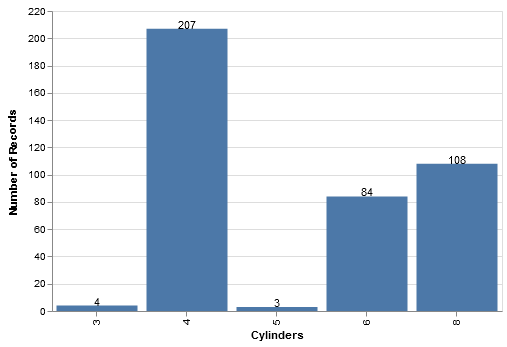

In [83]:
# We can layer a text chart onto other charts as well. For example, a bar chart here.

barchart = alt.Chart(
    data=cars
).mark_bar(
).encode(
    x='Cylinders:N',
    y='count()'
)

text = alt.Chart(
    data=cars
).mark_text(
).encode(
    x='Cylinders:N',
    y='count()',
    text='count()'
)

barchart + text

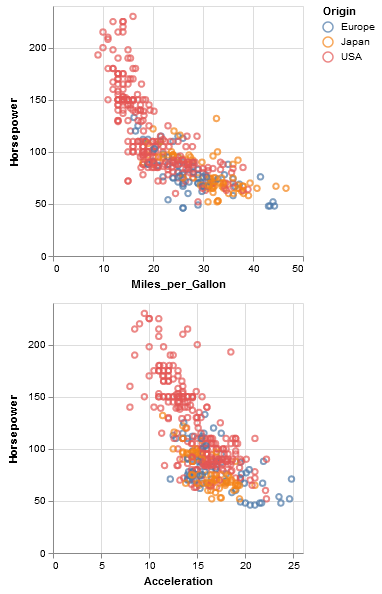

In [93]:
# Let's create a display with two charts concatenated vertically

scatter1 = alt.Chart(
    data=cars
).mark_point(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color='Origin:N'
).properties(
    width=250,
    height=250
)

scatter2 = alt.Chart(
    data=cars
).mark_point(
).encode(
    x='Acceleration:Q',
    y='Horsepower:Q',
    color='Origin:N'
).properties(
    width=250,
    height=250
)


scatter1 & scatter2

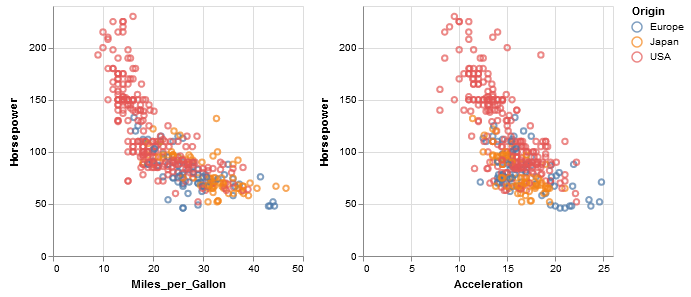

In [91]:
scatter1 | scatter2

## Adding More Interactivity: Selections

#### alt.selection_interval()
#### alt.selection_single()
#### alt.selection_multi()

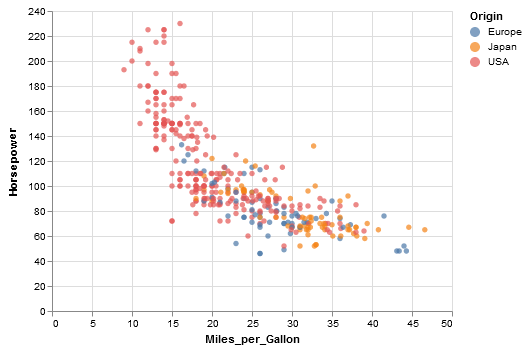

In [94]:
# A selection interval allows the user to highlight a region by clicking and dragging. 
# Shows up as a gray box on the plot.
brush = alt.selection_interval()

# The selected area (here called 'brush') can be used as a test in a conditional statement.
# In this example, if the points are in the brush area they are colored according to the field
# 'Origin', else they are colored light grey.

# Note the following behavior:
#   (1) Click and drag in the plot area to highlight a rectangle.
#   (2) Click and hold on the rectangle to drag it around the plot.
#   (3) Shift-Click the rectangle to lock it to the cursor. Drag around and then click to release.
#   (4) Two-finger scroll to make the rectangle larger/smaller.

alt.Chart(
    data=cars
).mark_circle(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color='Origin:N'
).add_selection(brush)

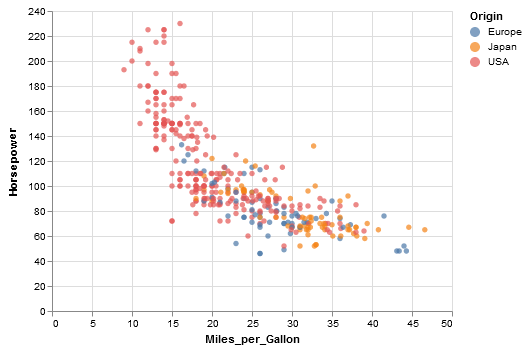

In [5]:
# So far, the selection does not do anything.  A selection can be used as a test in a conditional
# statement or as a data filter. Here, we'll add a conditional statement to the color channel.
# If the points are in the brush area they are colored according to the field
# 'Origin', else they are colored light grey.  Note that by default, when the chart renders,
# all of the data points are selected.

brush = alt.selection_interval()

alt.Chart(
    data=cars
).mark_circle(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color=alt.condition(brush, 'Origin:N', alt.value('lightgrey')),
).add_selection(brush)

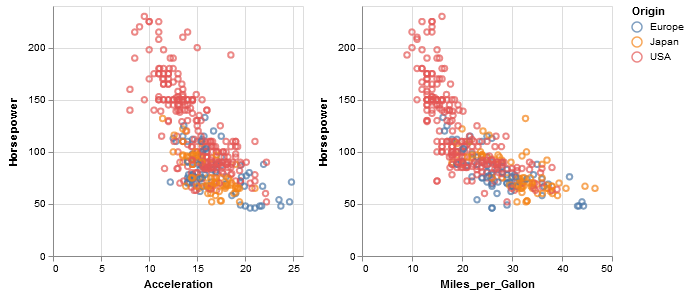

In [98]:
# We can assign the brush test for the color encoding channel for two graphs. If a
# a selection is made in one, it automatically affects the other graph.

brush = alt.selection_interval()

chart1 = alt.Chart(
    cars
).mark_point(
).encode(
    x='Acceleration:Q',
    y='Horsepower:Q',
    color=alt.condition(brush, 'Origin:N', alt.value('lightgrey'))
).add_selection(
    brush
).properties(
    width=250,
    height=250
)

chart2 = alt.Chart(
    cars
).mark_point(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color=alt.condition(brush, 'Origin:N', alt.value('lightgrey'))
).add_selection(
    brush
).properties(
    width=250,
    height=250
)

chart1 | chart2

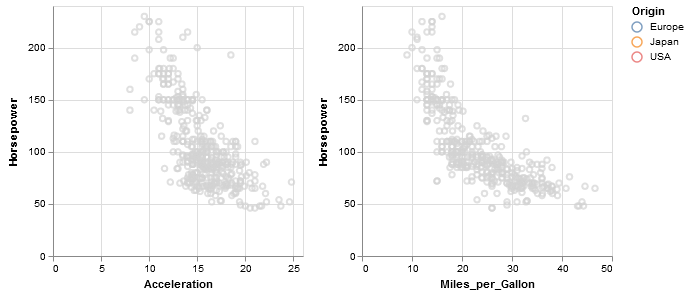

In [112]:
# Same graphs as above, but let's play with some selection properties.

brush = alt.selection_multi(empty='none', encodings=['x', 'y'])

chart1 = alt.Chart(
    cars
).mark_point(
).encode(
    x='Acceleration:Q',
    y='Horsepower:Q',
    color=alt.condition(brush, 'Origin:N', alt.value('lightgrey'))
).add_selection(
    brush
).properties(
    width=250,
    height=250
)

chart2 = alt.Chart(
    cars
).mark_point(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color=alt.condition(brush, 'Origin:N', alt.value('lightgrey'))
).add_selection(
    brush
).properties(
    width=250,
    height=250
)

chart1 | chart2

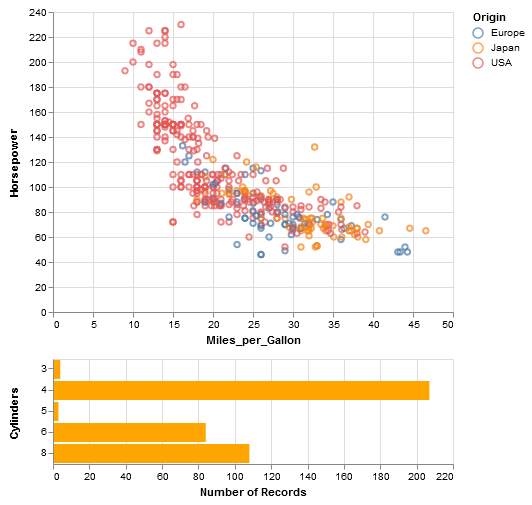

In [113]:
# Let's make a bar chart of the cylinders to accompany a scatter plot.  When we click on
# one of the bars, we want the scatter plot to be affected.

brush = alt.selection_single(encodings=['y'])

scatter = alt.Chart(
    data=cars
).mark_point(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color=alt.condition(brush, 'Origin:N', alt.value('lightgrey'))
).interactive()

cylinders = alt.Chart(
    data=cars
).mark_bar(
).encode(
    x='count()',
    y='Cylinders:N',
    color=alt.condition(brush, alt.value('orange'), alt.value('blue'))
).add_selection(
    brush
)

scatter & cylinders

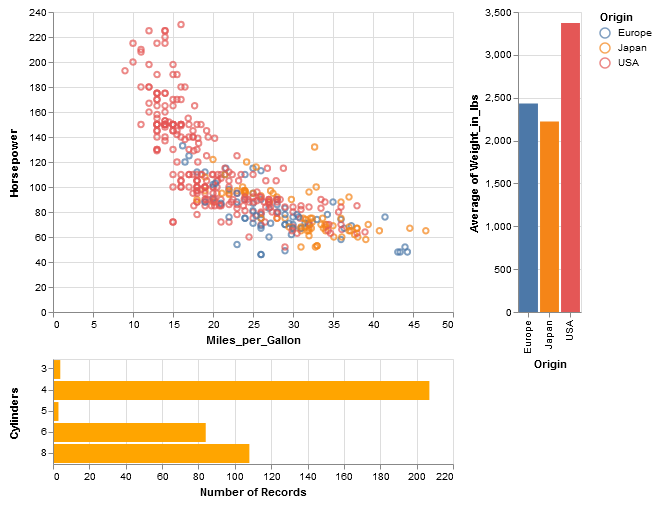

In [107]:
# An example with three charts. Note that the brush is only added to the cylinders 
# chart (i.e. the only chart with selection_add()) The brush is used in the following ways:
# (1) In a condition to affect the color of the points in the scatter plot
# (2) In a condition to affect the color of the bars in the cylinder chart
# (3) In a transform_filter() to filter the data used in the calculation of
#      average weight in the avg_weight chart.

brush = alt.selection_single(encodings=['y'])

scatter = alt.Chart(
    data=cars
).mark_point(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color=alt.condition(brush, 'Origin:N', alt.value('lightgrey'))
).interactive()

cylinders = alt.Chart(
    data=cars
).mark_bar(
).encode(
    x='count()',
    y='Cylinders:N',
    color=alt.condition(brush, alt.value('orange'), alt.value('blue'))
).add_selection(
    brush
)

avg_weight = alt.Chart(
    data=cars
).mark_bar(
).encode(
    x='Origin:N',
    y='average(Weight_in_lbs):Q',
    color='Origin:N'
).transform_filter(
    brush
)


(scatter & cylinders) | avg_weight

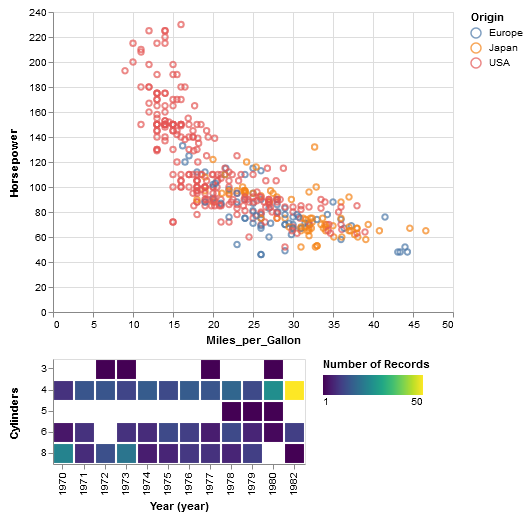

In [105]:
brush = alt.selection_multi(encodings=['x', 'y'])

scatter = alt.Chart(
    data=cars
).mark_point(
).encode(
    x='Miles_per_Gallon:Q',
    y='Horsepower:Q',
    color=alt.condition(brush, 'Origin:N', alt.value('lightgrey'))
).interactive()

heatmap = alt.Chart(
    data=cars
).mark_rect(
).encode(
    x=alt.X('Year:O', timeUnit='year'),
    y='Cylinders:O',
    color=alt.condition(brush, 'count()', alt.value('lightgrey'))
).add_selection(
    brush
)

scatter & heatmap